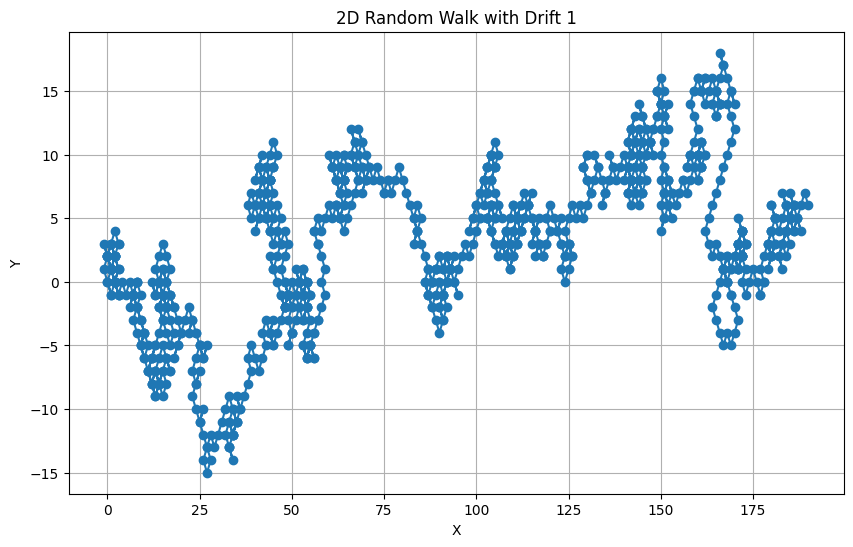

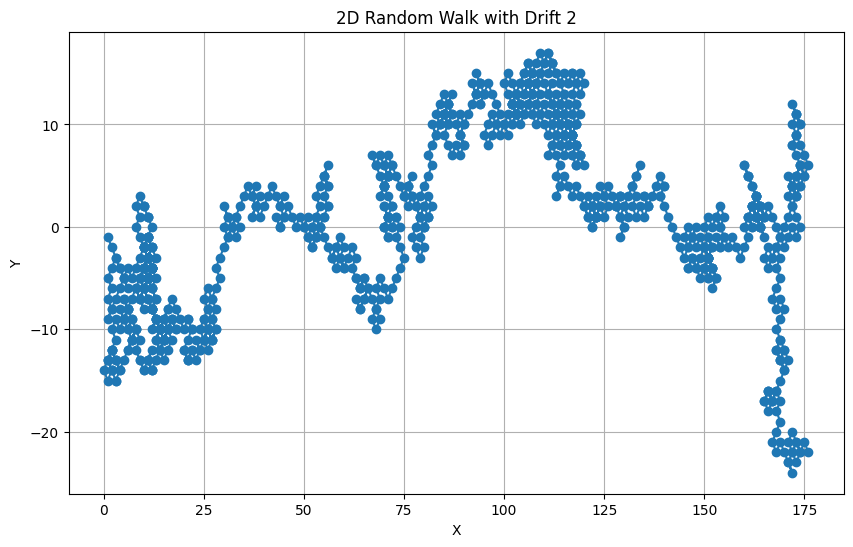

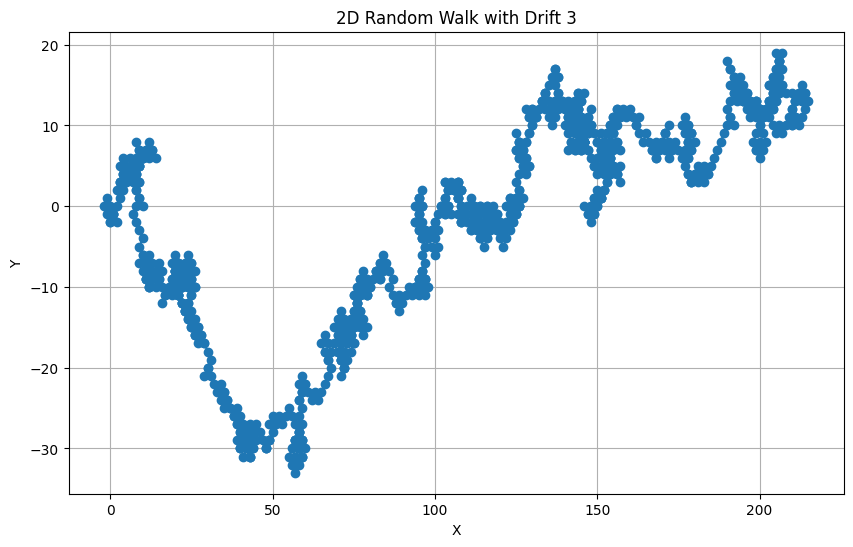

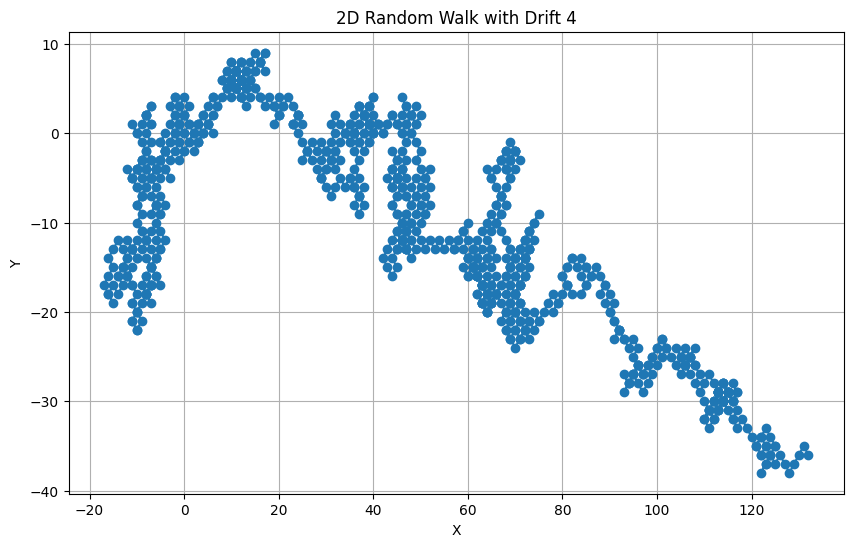

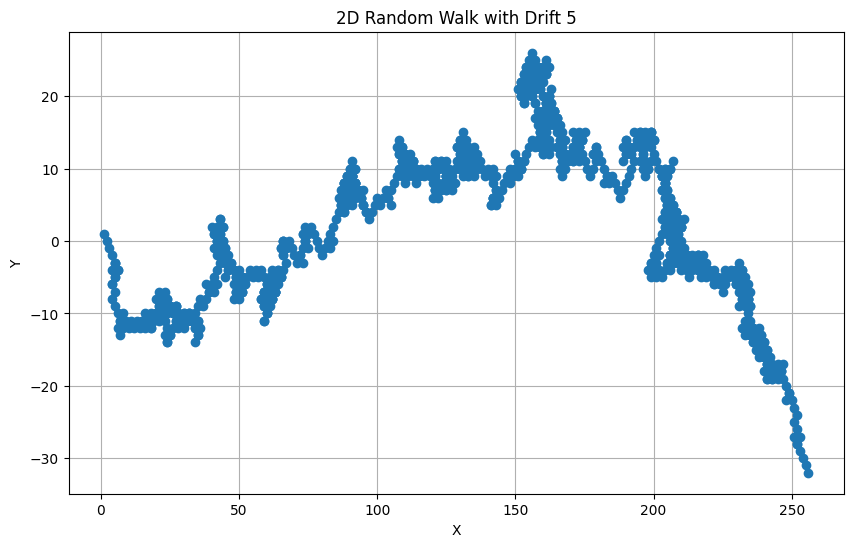

...

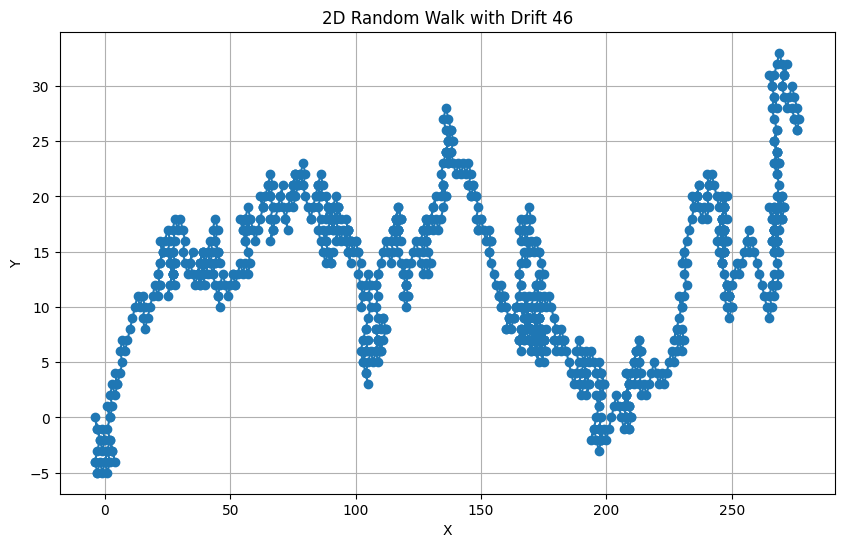

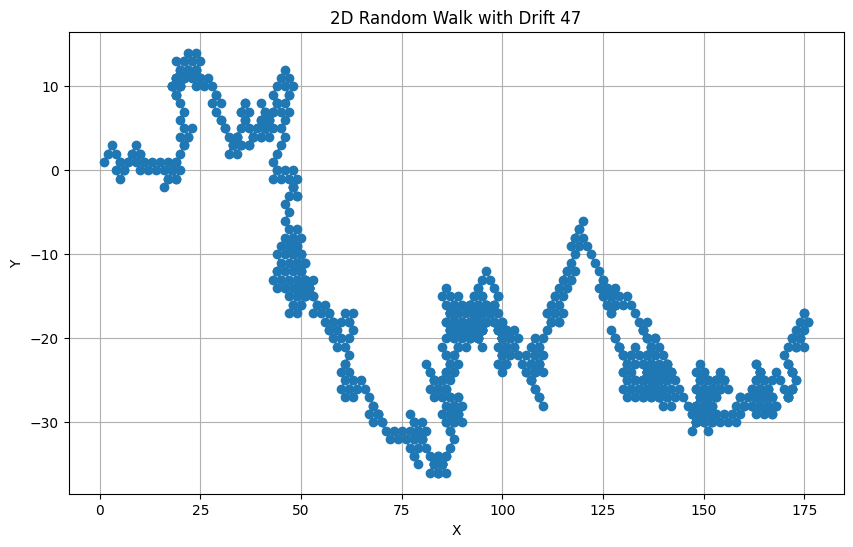

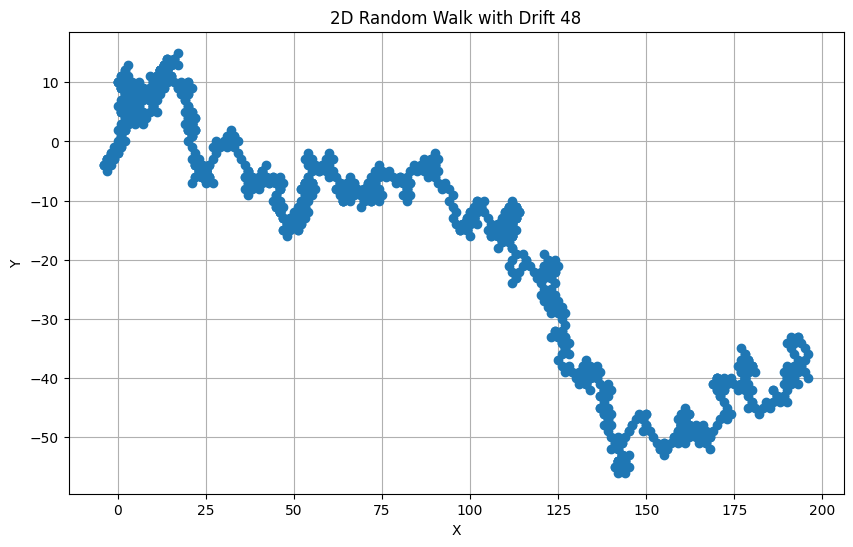

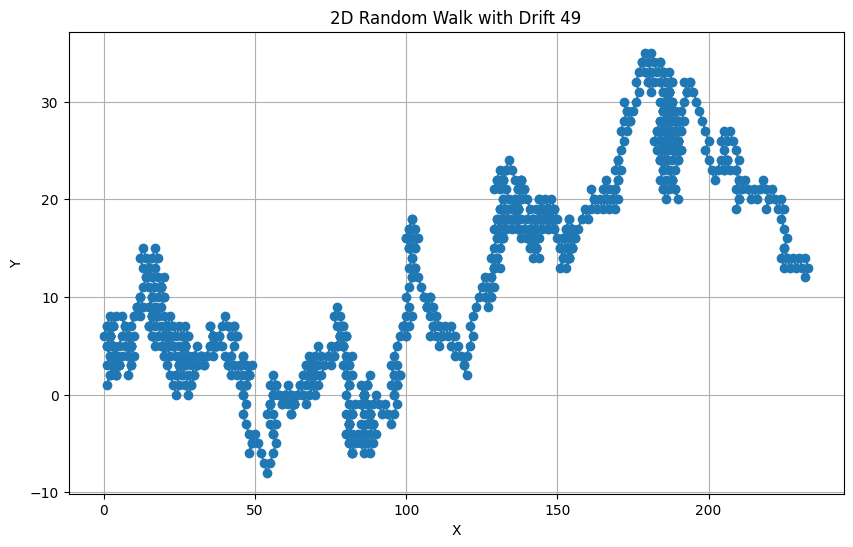

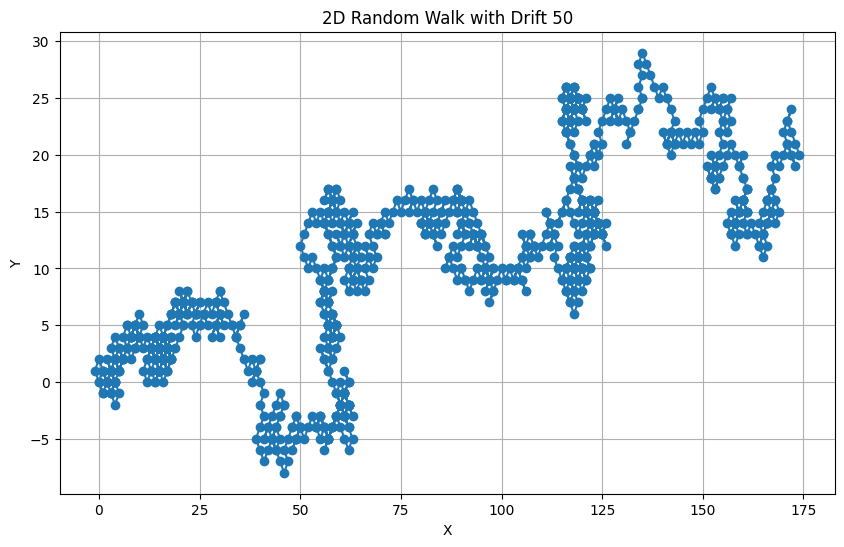

In [1]:
import numpy as np
import matplotlib.pyplot as plt

num_walks = 50
num_steps = 1000

p_right = 0.6  # Set this value > 0.5 for a drift to the right

for i in range(num_walks):
    x = np.zeros(num_steps)
    y = np.zeros(num_steps)

    x_steps = np.where(np.random.rand(num_steps) < p_right, 1, -1)
    y_steps = np.random.choice([-1, 1], size=num_steps)

    x = np.cumsum(x_steps)
    y = np.cumsum(y_steps)

    coordinates = np.column_stack((x, y))

    filename = f'random_walk_with_drift_{i+1}_coordinates.txt'

    np.savetxt(filename, coordinates)

    plt.figure(figsize=(10, 6))
    plt.plot(x, y, marker='o')
    plt.title(f'2D Random Walk with Drift {i+1}')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.grid(True)
    plt.savefig(f'random_walk_with_drift_{i+1}.png')
    plt.show()


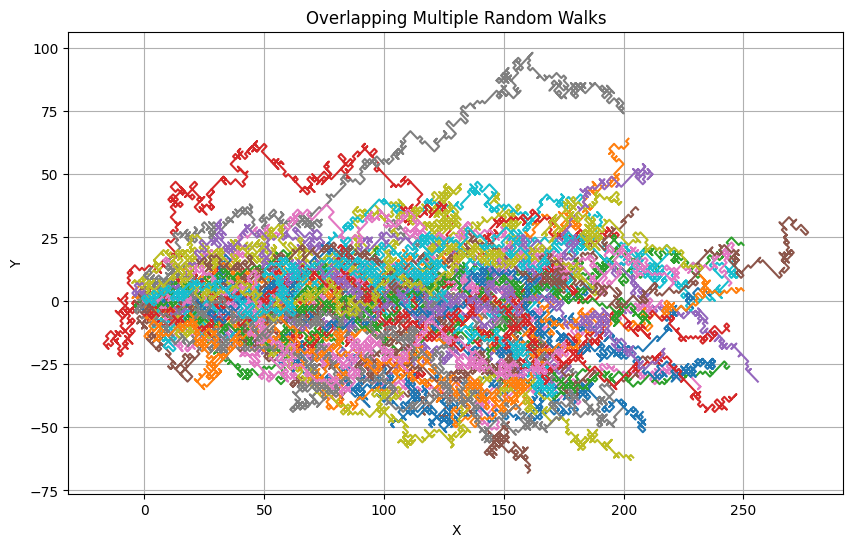

In [4]:
# List of filenames corresponding to the saved random walks
filenames = []

for i in range(num_walks): 
    filenames.append(f'random_walk_with_drift_{i+1}_coordinates.txt')

fig, ax = plt.subplots(figsize=(10, 6))
plt.grid(True)

for filename in filenames:
    loaded_coordinates = np.loadtxt(filename)

    x = loaded_coordinates[:, 0]
    y = loaded_coordinates[:, 1]

    plt.plot(x, y)

plt.xlabel('X')
plt.ylabel('Y')
plt.title('Overlapping Multiple Random Walks')
plt.show()

Animation size has reached 21000745 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


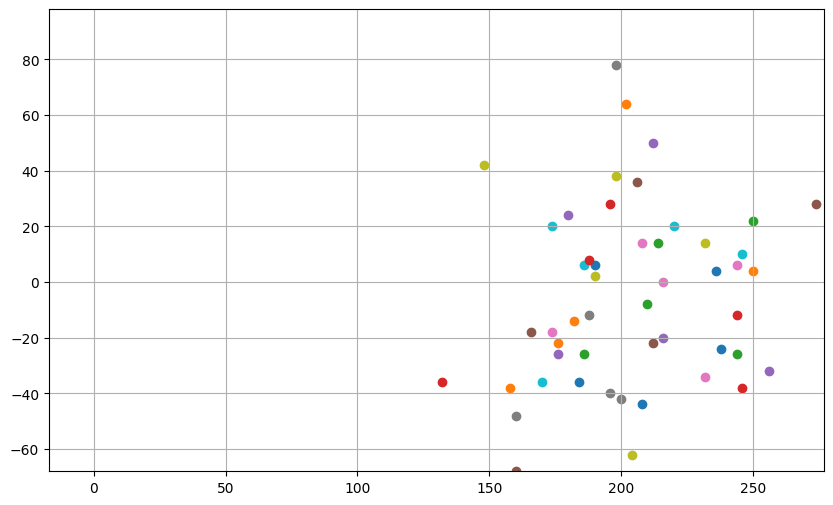

In [5]:
# gleiches wie in 2D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

walks = [np.loadtxt(filename) for filename in filenames]

fig, ax = plt.subplots(figsize=(10, 6))
plt.grid(True)

ax.set_xlim(min(walk[:, 0].min() for walk in walks), max(walk[:, 0].max() for walk in walks))
ax.set_ylim(min(walk[:, 1].min() for walk in walks), max(walk[:, 1].max() for walk in walks))

scatters = [ax.scatter(walk[0, 0], walk[0, 1]) for walk in walks]

def update(frame):
    for walk, scatter in zip(walks, scatters):
        scatter.set_offsets(walk[frame])

ani = FuncAnimation(fig, update, frames=len(walks[0]), interval=50)

HTML(ani.to_jshtml())

In [ ]:
ani.save('animation.mp4', fps=30)